In [1]:
%pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


In [2]:
from ultralytics import YOLO
from colorsys import hsv_to_rgb
from numpy import linspace
from itertools import product
from PIL import Image
from matplotlib import pyplot as plt
from matplotlib import patches
import os

/home/lipeama/repos/Proj-Comp-1/.venv/lib/python3.12/site-packages/torch/lib/libtorch_global_deps.so


In [3]:
# função IOU
def iou(box1, box2):
    l1, t1, r1, b1, *_ = box1
    l2, t2, r2, b2, *_ = box2
    w1 = r1 - l1
    w2 = r2 - l2
    h1 = b1 - t1
    h2 = b2 - t2
    union_w = max(r1, r2) - min(l1, l2)
    inter_w = max(0, w1 + w2 - union_w)
    union_h = max(b1, b2) - min(t1, t2)
    inter_h = max(0, h1 + h2 - union_h)
    return inter_h * inter_w / (union_h * union_w)

In [4]:
# Inicialização da rede
model = YOLO('yolov3u.pt')
with open('coco.names', 'r') as f:
    labels = [label.translate({10:None}) for label in f.readlines()]

hsv = product(linspace(0,0.9, 20), (1, 0.5), (1,0.5))
rgb = [hsv_to_rgb(h, s, v) for (h,s,v) in hsv]
colors = rgb


In [5]:
def detectImage(imgpath: str, iou_thresh: float = 0.5, show_label: bool = True, show_prob: bool = True):
    result = model.predict(source=imgpath, conf=0.5, iou=1, imgsz= 640)[0]
    boxes = [tuple(map(float, box)) for box in result.boxes.data]
    valid_boxes = []
    while len(boxes):
        box = boxes.pop(0)
        valid_boxes.append(box)
        i = 0
        while i < len(boxes):
            if box[5] == boxes[i][5] and iou(box, boxes[i]) > iou_thresh:
                boxes.pop(i)
            else:
                i += 1
    img = Image.open(imgpath)
    width, height = img.size
    fig, ax = plt.subplots()
    ax.imshow(img)
    for (l,t,r,b,prob,label) in valid_boxes:
        color = colors[int(label)]
        rect=patches.Rectangle((l,b), r-l, t-b, linewidth=1, edgecolor=color, fill=None)
        ax.add_patch(rect)
        text = ''
        if show_label == True:
            text += f'{labels[int(label)]}'
        if show_prob == True:
            text += f' [{prob*100:.1f}%]'
        if show_label or show_prob:
            ax.text(l, t, text, color=color)
    plt.show()

def detectDirectory(dirpath: str, iou_thresh: float = 0.5, show_label: bool = True, show_prob: bool = True):
    allowed_extensions =  {'mpo', 'jpg', 'dng', 'png', 'jpeg', 'webp', 'pfm', 'tiff', 'bmp', 'tif'}
    for imgpath in os.listdir(dirpath):
        *_, ext = imgpath.split('.')
        if ext in allowed_extensions:
            detectImage(dirpath+imgpath, iou_thresh=iou_thresh, show_label= show_label, show_prob=show_prob)


/home/lipeama/repos/Proj-Comp-1/.venv/lib/python3.12/site-packages/torchvision/_C.so
/home/lipeama/repos/Proj-Comp-1/.venv/lib/python3.12/site-packages/torchvision/image.so
image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/person.jpg: 448x640 10 persons, 10 dogs, 10 horses, 644.0ms
Speed: 1.1ms preprocess, 644.0ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


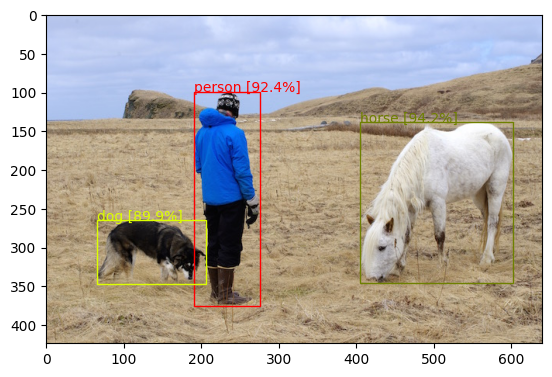


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/motorbike.jpg: 448x640 9 persons, 10 motorcycles, 647.6ms
Speed: 1.0ms preprocess, 647.6ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


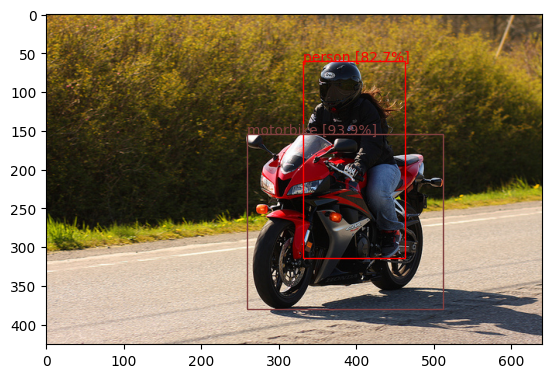


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/giraffe.jpg: 640x640 10 zebras, 10 giraffes, 942.0ms
Speed: 2.1ms preprocess, 942.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


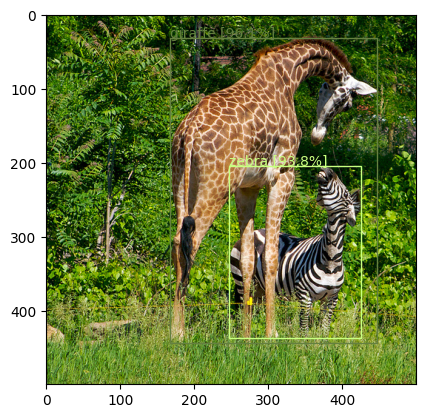


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/surf.jpg: 448x640 10 persons, 10 surfboards, 629.5ms
Speed: 1.0ms preprocess, 629.5ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


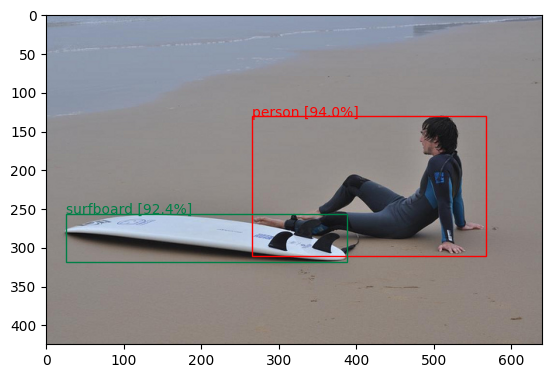


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/dog2.jpg: 448x640 19 persons, 10 bicycles, 10 dogs, 664.3ms
Speed: 0.9ms preprocess, 664.3ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


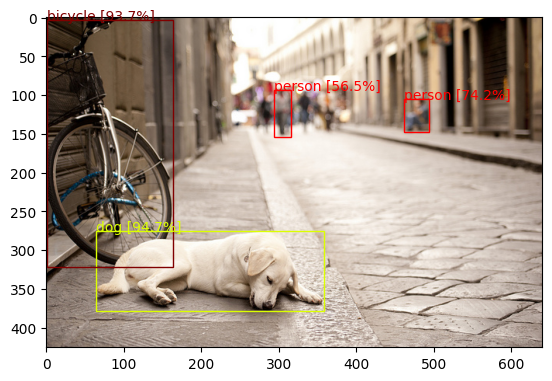


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/city_scene.jpg: 416x640 34 persons, 46 cars, 13 traffic lights, 2 handbags, 580.6ms
Speed: 2.6ms preprocess, 580.6ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


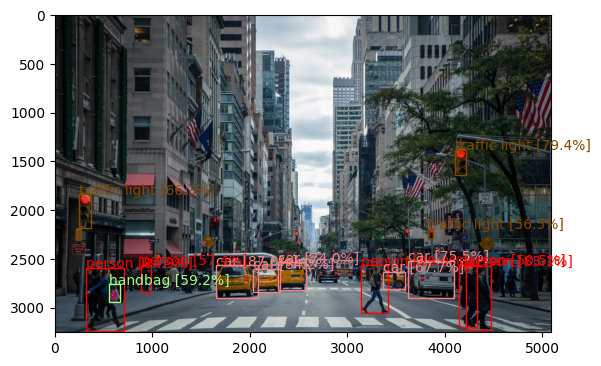


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/eagle.jpg: 448x640 10 birds, 629.1ms
Speed: 1.9ms preprocess, 629.1ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


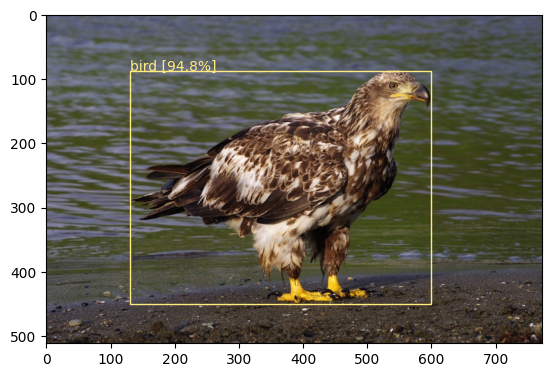


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/cat.jpg: 480x640 9 cats, 710.9ms
Speed: 1.6ms preprocess, 710.9ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)


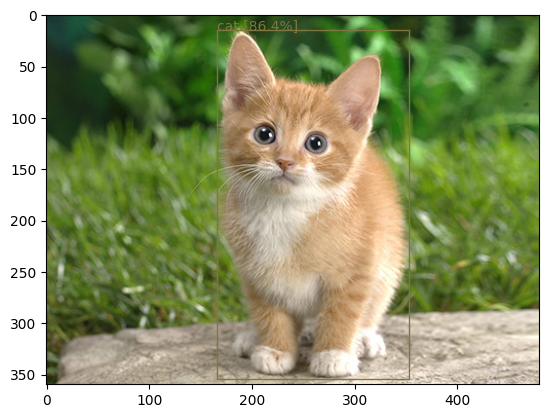


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/wine.jpg: 640x448 10 bottles, 10 wine glasss, 20 chairs, 10 dining tables, 633.6ms
Speed: 1.0ms preprocess, 633.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 448)


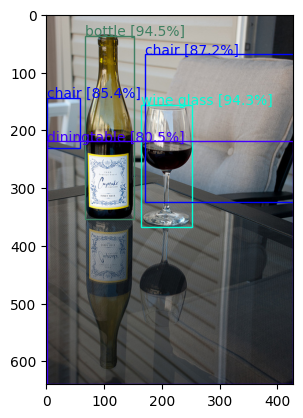


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/food.jpg: 480x640 50 spoons, 94 bowls, 2 carrots, 3 dining tables, 682.8ms
Speed: 1.2ms preprocess, 682.8ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


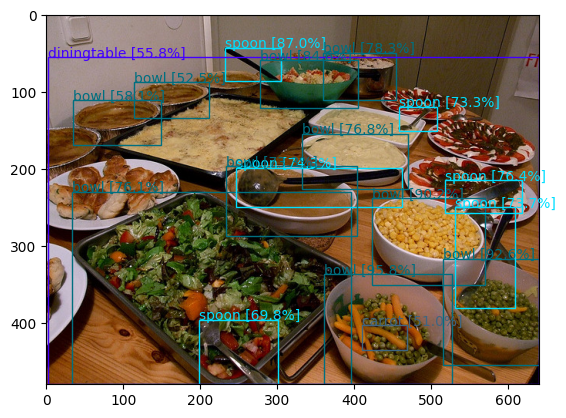


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/horses.jpg: 448x640 32 horses, 693.6ms
Speed: 1.5ms preprocess, 693.6ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)


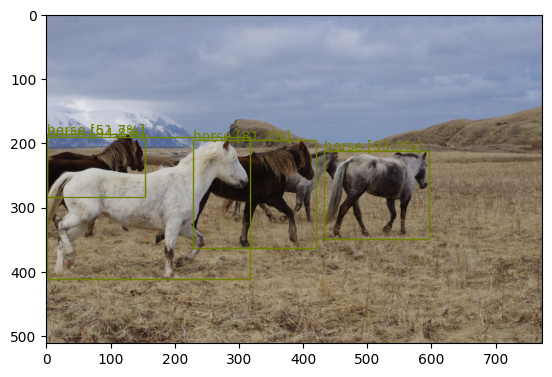


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/default/dog.jpg: 480x640 10 bicycles, 1 car, 3 trucks, 10 dogs, 686.1ms
Speed: 1.8ms preprocess, 686.1ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


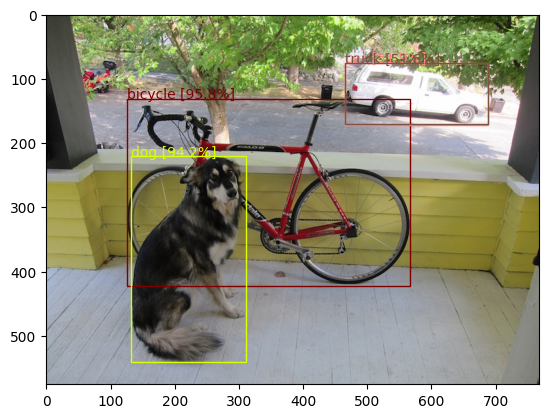

In [6]:
detectDirectory('images/default/', iou_thresh=0.5)


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/3 - QKjGn9Q.png: 640x480 10 persons, 4 cars, 10 fire hydrants, 734.4ms
Speed: 2.6ms preprocess, 734.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)


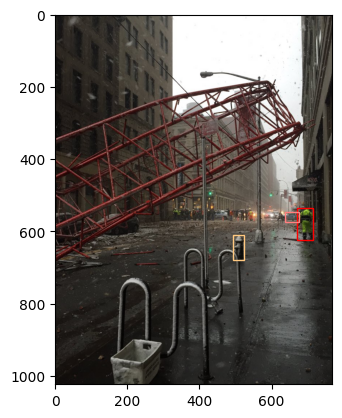


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/8 - 8RKFRIQ.jpg: 576x640 80 persons, 837.1ms
Speed: 1.8ms preprocess, 837.1ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)


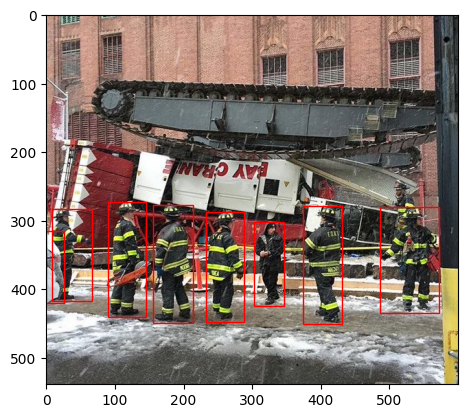


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/2 - xdGTGdb.jpg: 640x480 68 persons, 20 cars, 704.7ms
Speed: 1.7ms preprocess, 704.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 480)


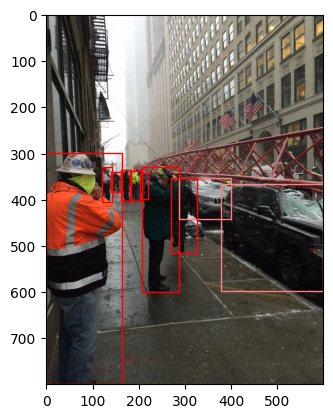


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/6 - unb7Vk9.jpg: 480x640 9 persons, 680.0ms
Speed: 1.6ms preprocess, 680.0ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)


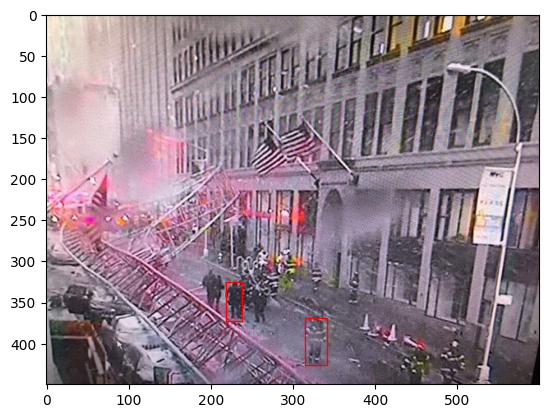


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/5 - 92zKI6u.png: 480x640 18 persons, 667.3ms
Speed: 2.3ms preprocess, 667.3ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


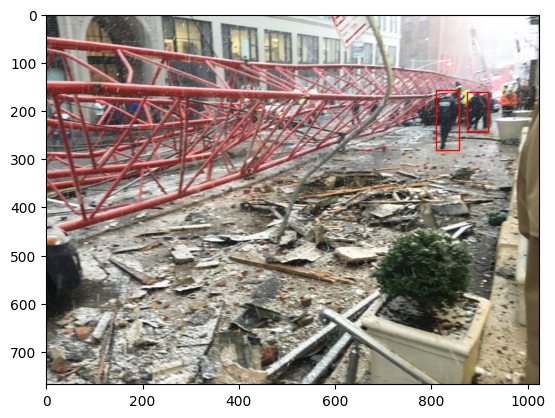


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/1 - A92DJeJ.jpg: 640x480 10 trucks, 729.8ms
Speed: 1.7ms preprocess, 729.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)


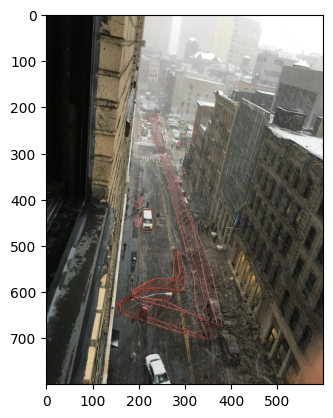


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/7 - 9JLyDYZ.jpg: 640x640 58 persons, 5 traffic lights, 925.1ms
Speed: 2.1ms preprocess, 925.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


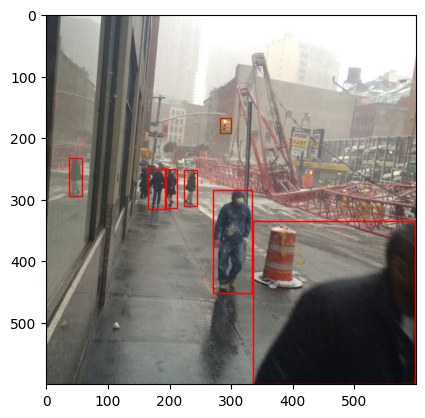


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/crane/4 - g1AVnt9.png: 480x640 57 persons, 2 cell phones, 681.5ms
Speed: 2.0ms preprocess, 681.5ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)


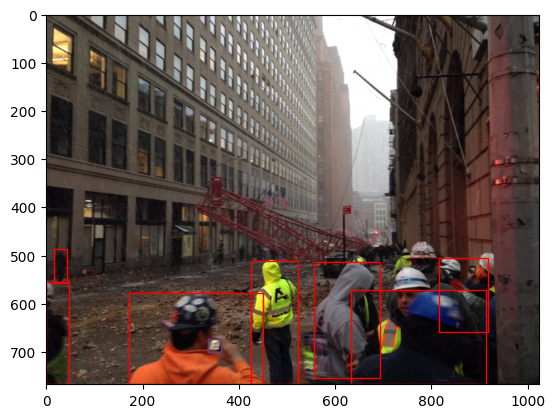

In [7]:
detectDirectory('images/crane/', iou_thresh=0.5, show_label=False, show_prob=False)


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/doggo/3 - htVVZpH.png: 640x640 10 dogs, 944.5ms
Speed: 2.3ms preprocess, 944.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


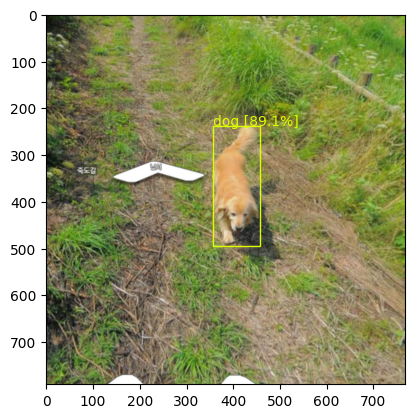


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/doggo/1 - RpEnswm.png: 640x544 10 dogs, 784.8ms
Speed: 2.1ms preprocess, 784.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 544)


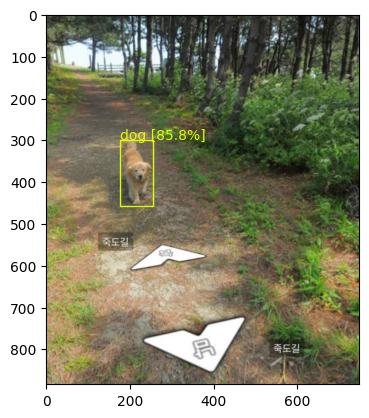


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/doggo/4 - vmho91C.png: 640x544 1 dog, 794.5ms
Speed: 1.8ms preprocess, 794.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 544)


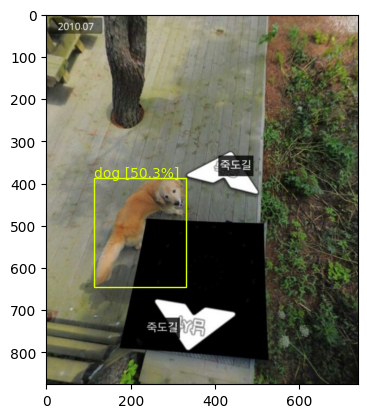


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/doggo/2 - S3DK5hi.png: 576x640 10 dogs, 816.5ms
Speed: 2.2ms preprocess, 816.5ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)


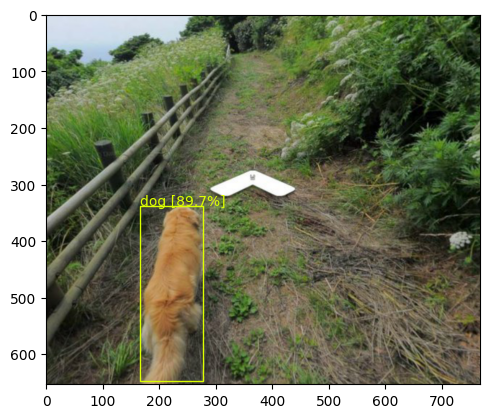


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/doggo/5 - 1EsqT0F.png: 640x576 10 cats, 888.7ms
Speed: 2.1ms preprocess, 888.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 576)


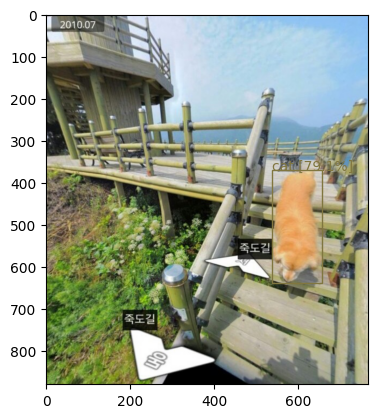

In [8]:
detectDirectory('images/doggo/', iou_thresh=0.5)


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/11 - ARr1YEe - Fish Stew with fennel and baby potatoes.jpg: 416x640 20 bowls, 9 dining tables, 594.1ms
Speed: 1.4ms preprocess, 594.1ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


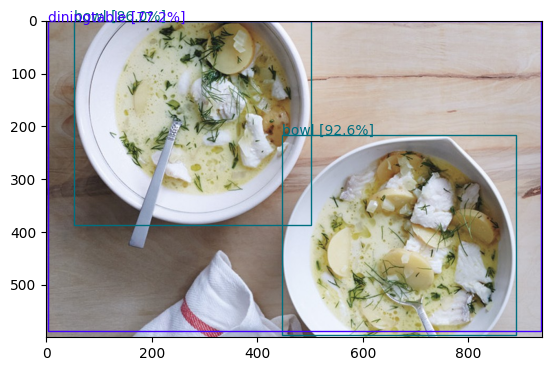


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/6 - YklyGZv - Andouille and Beef Burgers with Spicy Mayo and Caramelized Onions.jpg: 512x640 10 sandwichs, 729.6ms
Speed: 1.5ms preprocess, 729.6ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)


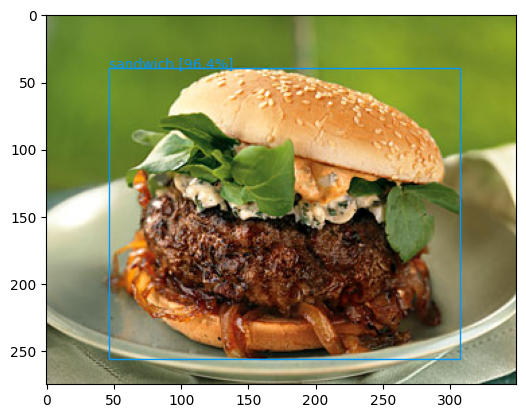


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/1 - bE4jFyr - BLT grilled cheese.jpg: 640x448 10 bowls, 10 sandwichs, 647.0ms
Speed: 1.5ms preprocess, 647.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 448)


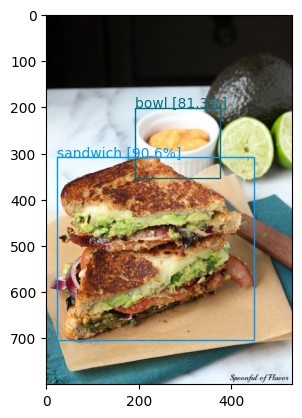


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/9 - nHDGYFB - Curried Pumpkin and.jpg: 448x640 10 spoons, 20 bowls, 656.3ms
Speed: 1.5ms preprocess, 656.3ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


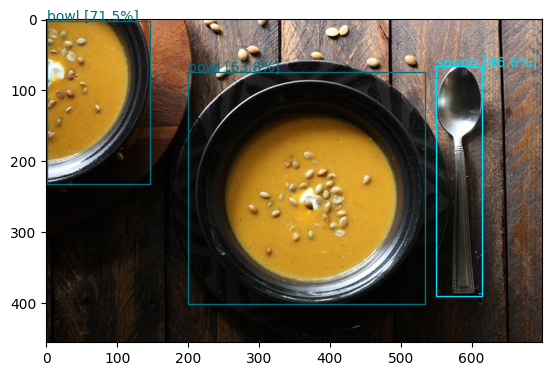


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/8 - 3PP2qOm - Italian Sausage Tortellini Soup.jpg: 640x448 9 bowls, 675.9ms
Speed: 2.0ms preprocess, 675.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 448)


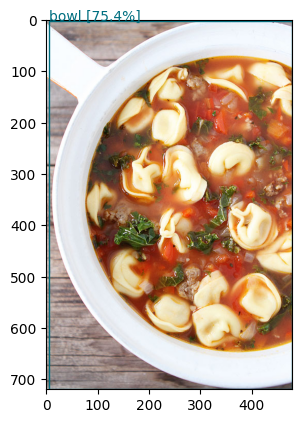


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/7 - VzYuGRN - Classic Tomato Soup.jpg: 544x640 20 spoons, 20 bowls, 10 sandwichs, 828.9ms
Speed: 1.8ms preprocess, 828.9ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)


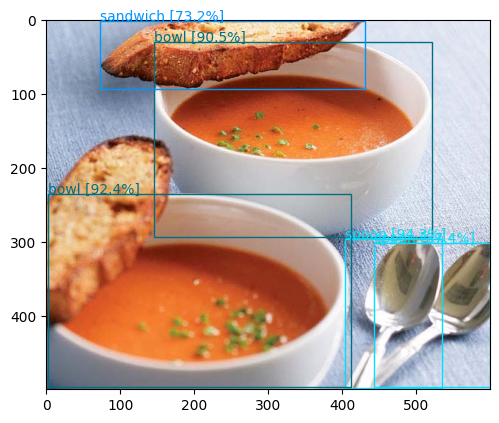


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/19 - gwHmdPZ - Grilled cinnamon toast with chocolate.jpg: 640x448 10 cakes, 719.9ms
Speed: 2.0ms preprocess, 719.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 448)


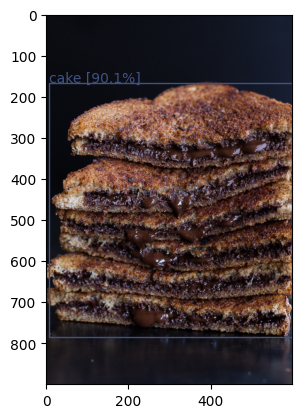


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/5 - 7QSOYyu - Bloomin' onion bread.jpg: 640x640 (no detections), 946.5ms
Speed: 1.7ms preprocess, 946.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


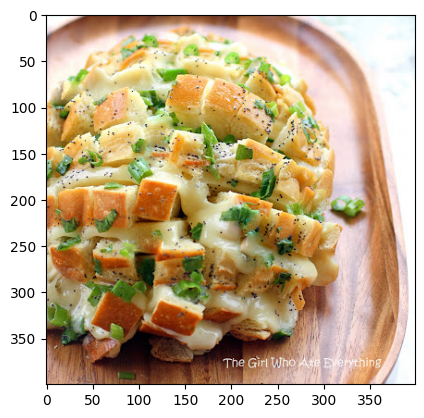


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/2 - 3rtBXp3 - Street Tacos.png: 640x448 10 sandwichs, 664.4ms
Speed: 1.7ms preprocess, 664.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 448)


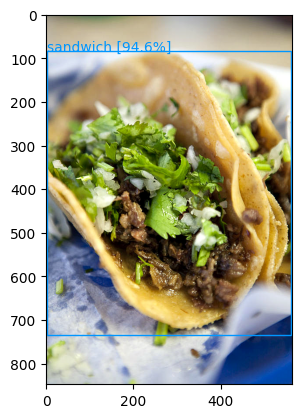


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/10 - oNSL3sl - Minestrone Soup.jpg: 640x640 10 spoons, 10 bowls, 986.9ms
Speed: 1.9ms preprocess, 986.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


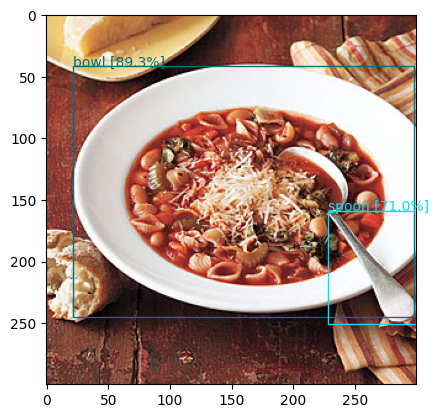


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/20 - YWlkhXR - Oatmeal cream pie bars.jpg: 640x416 10 cakes, 618.2ms
Speed: 1.4ms preprocess, 618.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)


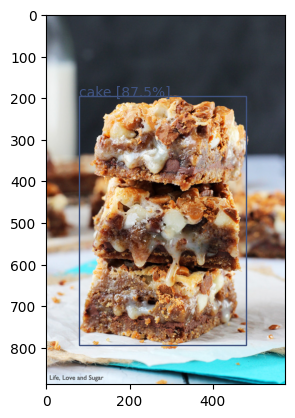


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/21 - PqQRmYq - Chocolate chip cookies.jpg: 640x448 20 cups, 6 dining tables, 667.7ms
Speed: 1.4ms preprocess, 667.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 448)


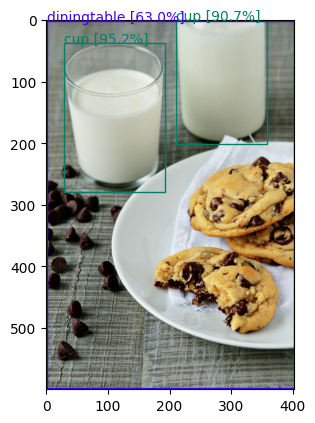


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/13 - nTCmnsd - Slow Cooker Root Vegetable Stew Recipe.jpg: 448x640 36 carrots, 697.2ms
Speed: 1.4ms preprocess, 697.2ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


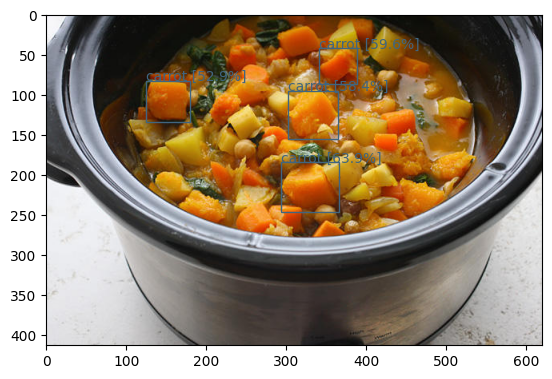


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/18 - harvl6V - Cinnamon roll waffles.jpg: 448x640 10 forks, 1 sandwich, 657.1ms
Speed: 1.5ms preprocess, 657.1ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


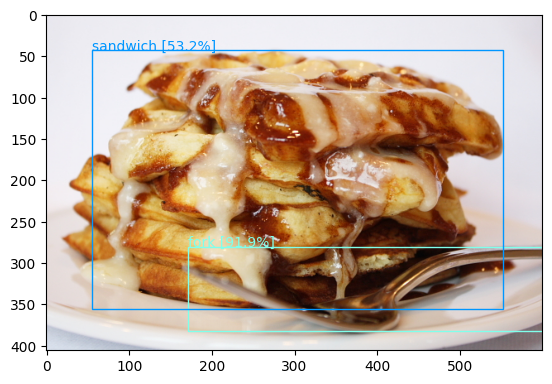


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/15 - V4bPmE7 - Butternut Squash Soup with Apple & Bacon.jpg: 544x640 6 spoons, 36 bowls, 1 dining table, 826.0ms
Speed: 2.2ms preprocess, 826.0ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)


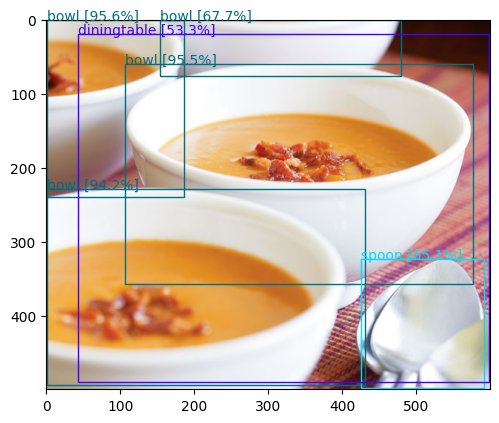


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/3 - Zuv9Ok6 - Beef Stew.jpg: 448x640 5 knifes, 18 bowls, 12 carrots, 655.3ms
Speed: 1.5ms preprocess, 655.3ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


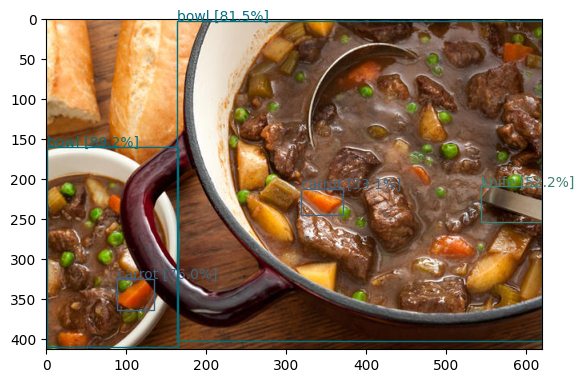


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/12 - 0tQWasR - Carrot ginger soup.jpg: 448x640 10 spoons, 10 bowls, 681.7ms
Speed: 1.6ms preprocess, 681.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


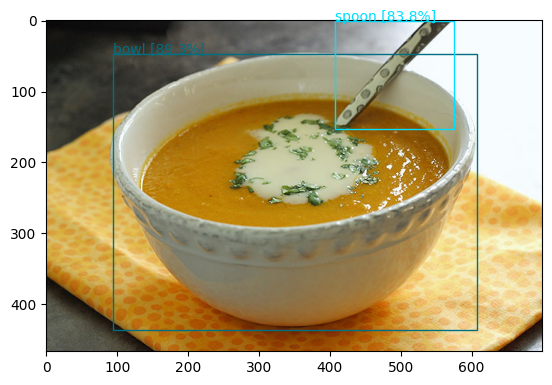


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/17 - fFxxTxa - Chicken Noodle Soup.jpg: 384x640 6 spoons, 10 bowls, 12 carrots, 562.5ms
Speed: 1.3ms preprocess, 562.5ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


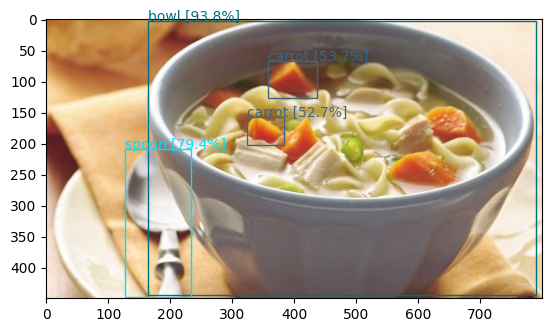


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/16 - rpi3c5v - Loaded Potato Soup.jpg: 384x640 5 pizzas, 575.3ms
Speed: 1.5ms preprocess, 575.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


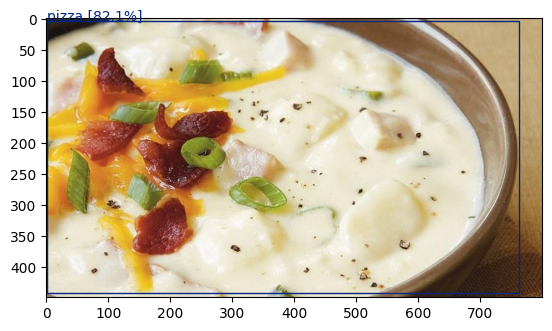


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/4 - oS8iw5q - Pizza Fries.jpg: 448x640 2 bottles, 10 bowls, 6 sandwichs, 656.7ms
Speed: 2.6ms preprocess, 656.7ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


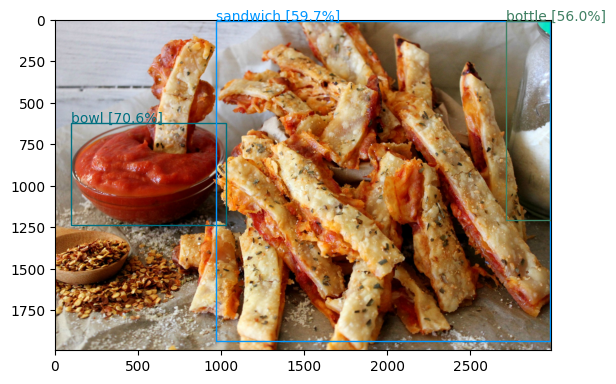


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/food/14 - M23UEUT - Creamy chicken and corn c.jpg: 640x448 10 spoons, 18 bowls, 705.1ms
Speed: 1.7ms preprocess, 705.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 448)


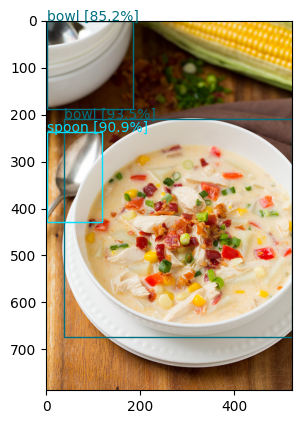

In [9]:
detectDirectory('images/food/', iou_thresh=0.5)


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/16 - ehikyYg.png: 352x640 16 persons, 510.9ms
Speed: 1.4ms preprocess, 510.9ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)


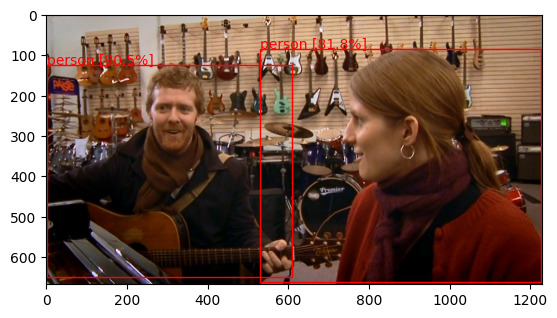


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/33 - 0Q5UEaG.jpg: 384x640 20 persons, 536.5ms
Speed: 1.5ms preprocess, 536.5ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


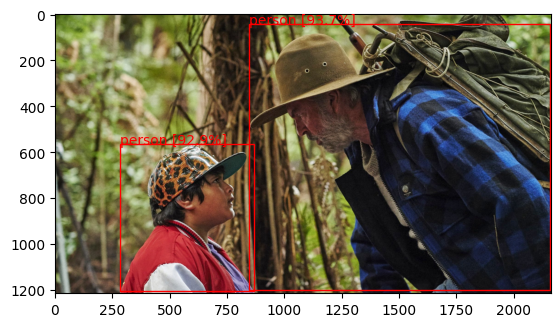


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/4 - WXujThY.jpg: 448x640 20 persons, 6 benchs, 20 cups, 643.7ms
Speed: 1.7ms preprocess, 643.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


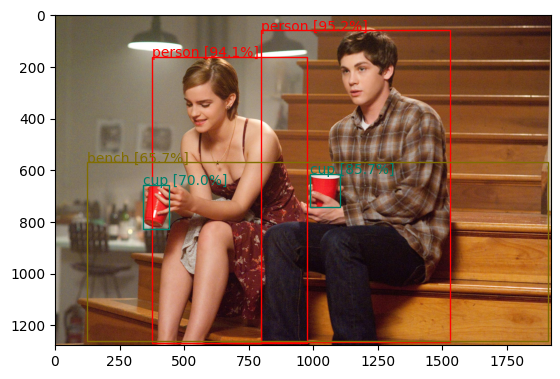


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/25 - 3xu1w5Y.jpg: 448x640 40 persons, 27 bottles, 20 wine glasss, 20 cups, 9 forks, 2 dining tables, 627.2ms
Speed: 1.5ms preprocess, 627.2ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


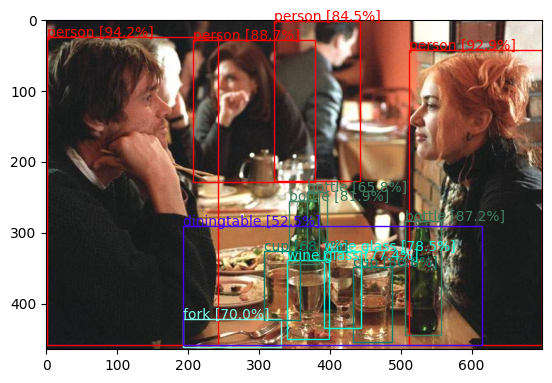


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/2 - clfKWrY.jpg: 288x640 20 persons, 9 ties, 441.2ms
Speed: 3.2ms preprocess, 441.2ms inference, 0.6ms postprocess per image at shape (1, 3, 288, 640)


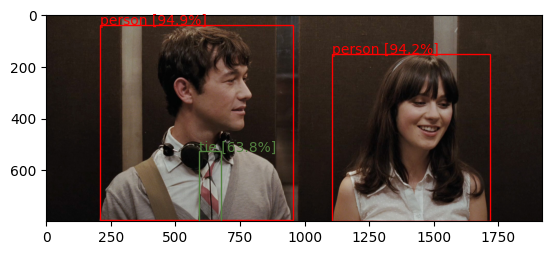


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/20 - qynFswG.jpg: 384x640 20 persons, 10 potted plants, 595.7ms
Speed: 1.1ms preprocess, 595.7ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


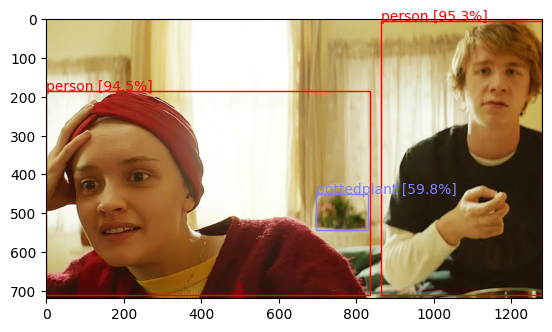


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/19 - ei1154Q.jpg: 448x640 20 persons, 10 cars, 10 bottles, 18 cups, 10 chairs, 10 dining tables, 641.5ms
Speed: 1.3ms preprocess, 641.5ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


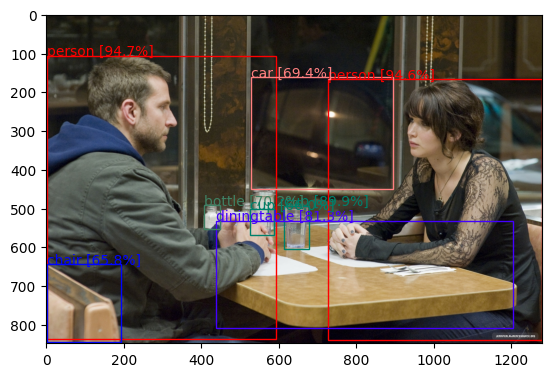


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/1 - KVoLrSj.jpg: 448x640 19 persons, 7 handbags, 642.7ms
Speed: 2.1ms preprocess, 642.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


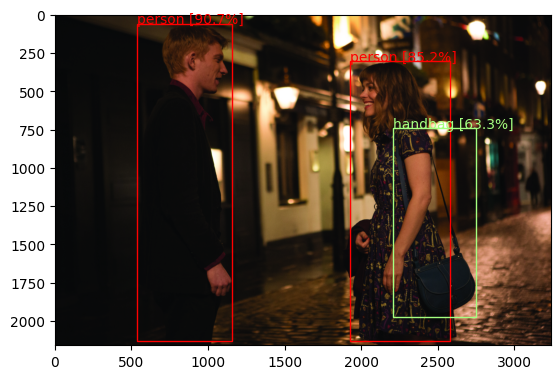


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/17 - 09rdtf8.jpg: 448x640 41 persons, 16 ties, 634.2ms
Speed: 1.6ms preprocess, 634.2ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


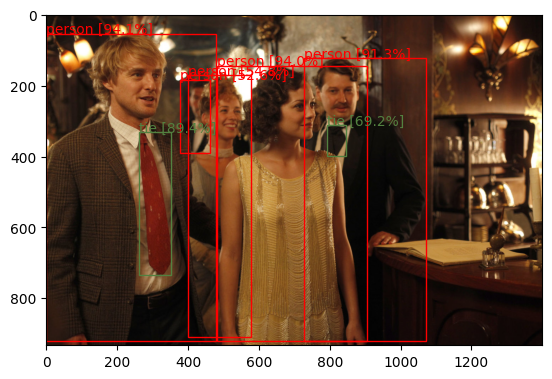


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/10 - jfj0wFR.jpg: 352x640 30 persons, 15 ties, 530.6ms
Speed: 1.3ms preprocess, 530.6ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)


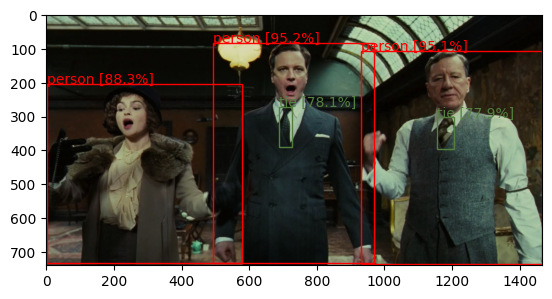


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/32 - eSlE7HY.jpg: 384x640 80 persons, 1 tie, 553.0ms
Speed: 1.9ms preprocess, 553.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


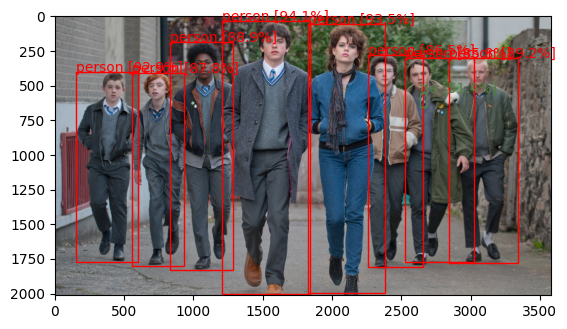


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/23 - yC2oHmV.jpg: 288x640 10 persons, 419.3ms
Speed: 3.3ms preprocess, 419.3ms inference, 0.7ms postprocess per image at shape (1, 3, 288, 640)


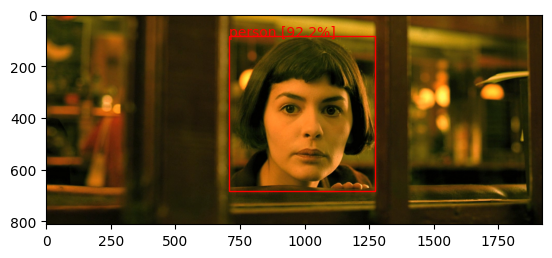


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/8 - rvutPxC.jpg: 352x640 20 persons, 567.3ms
Speed: 0.9ms preprocess, 567.3ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)


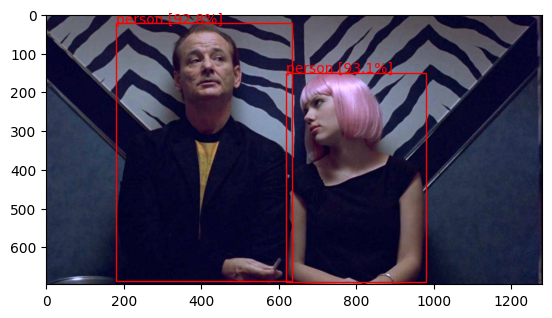


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/26 - SPfJw9z.jpg: 448x640 70 persons, 8 ties, 637.7ms
Speed: 2.1ms preprocess, 637.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


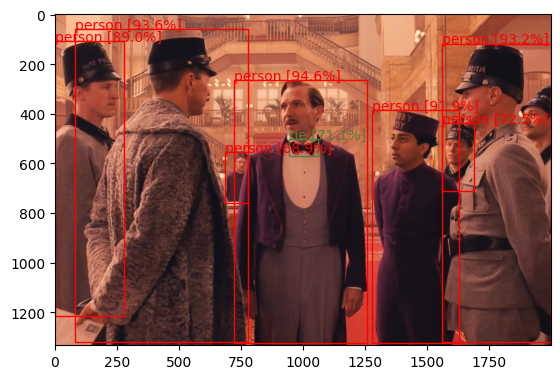


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/24 - lyyZP3i.jpg: 384x640 20 persons, 547.1ms
Speed: 1.6ms preprocess, 547.1ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


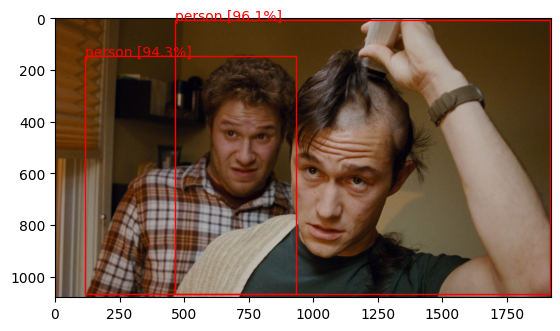


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/18 - cW7qLFr.jpg: 384x640 59 persons, 9 ties, 7 cups, 10 chairs, 602.1ms
Speed: 1.5ms preprocess, 602.1ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


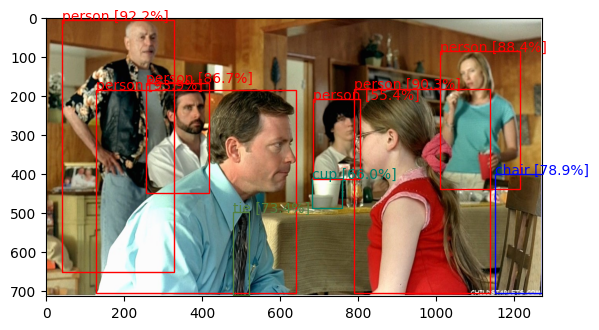


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/31 - W1ViU8B.jpg: 448x640 10 persons, 640.7ms
Speed: 1.6ms preprocess, 640.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


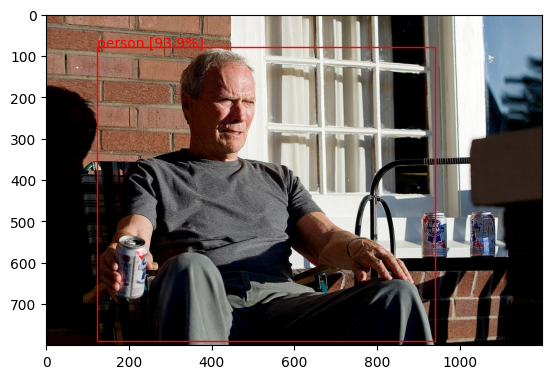


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/12 - hSbI3ZP.jpg: 352x640 10 persons, 582.1ms
Speed: 1.3ms preprocess, 582.1ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)


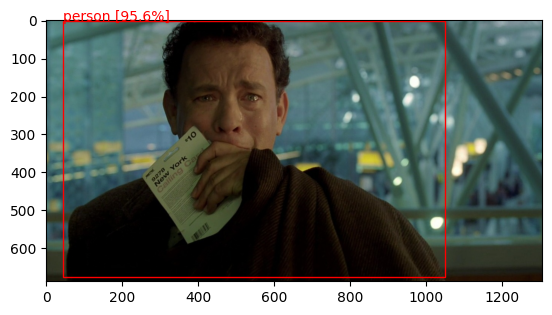


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/5 - E6rI4GY.jpg: 416x640 20 persons, 596.0ms
Speed: 1.2ms preprocess, 596.0ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


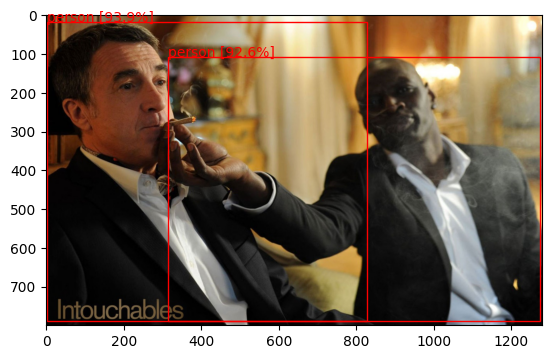


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/28 - pd6Vthl.jpg: 384x640 10 persons, 605.5ms
Speed: 1.5ms preprocess, 605.5ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


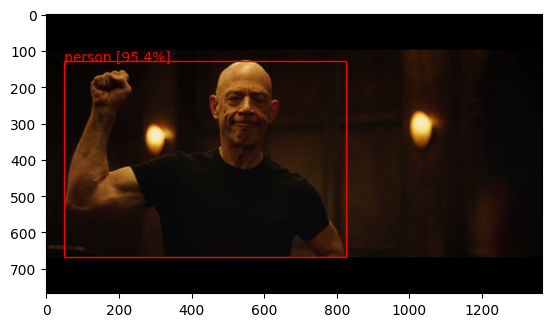


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/29 - v9HdzbF.jpg: 384x640 28 persons, 9 ties, 10 bottles, 20 cups, 10 bowls, 556.8ms
Speed: 2.3ms preprocess, 556.8ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)


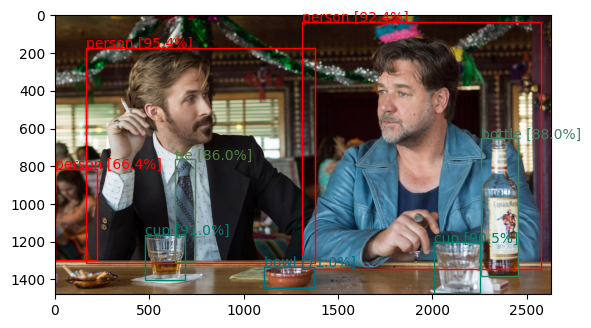


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/6 - LFcGZgm.jpg: 448x640 34 persons, 7 ties, 10 chairs, 731.5ms
Speed: 3.2ms preprocess, 731.5ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


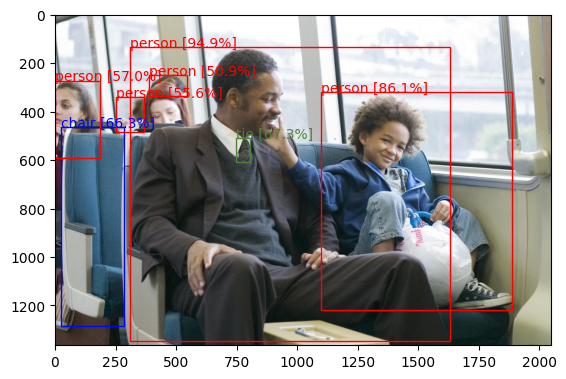


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/13 - Cn2XVVC.jpg: 448x640 29 persons, 686.0ms
Speed: 1.4ms preprocess, 686.0ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


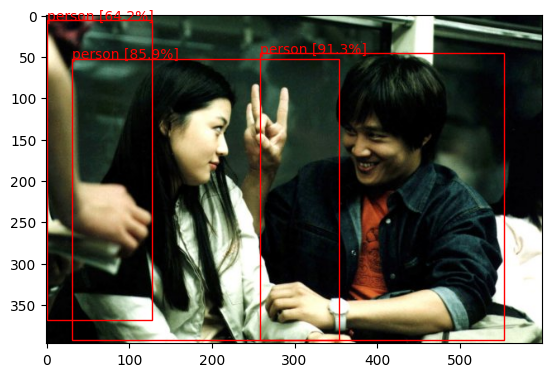


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/14 - K6N88xd.jpg: 512x640 13 persons, 10 ties, 816.3ms
Speed: 2.6ms preprocess, 816.3ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)


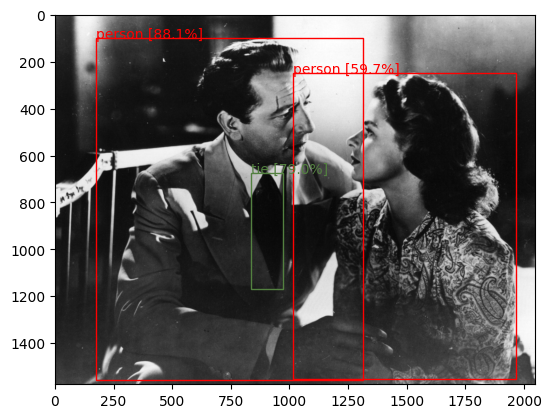


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/11 - lbxyDE5.jpg: 352x640 44 persons, 3 cell phones, 571.6ms
Speed: 1.3ms preprocess, 571.6ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)


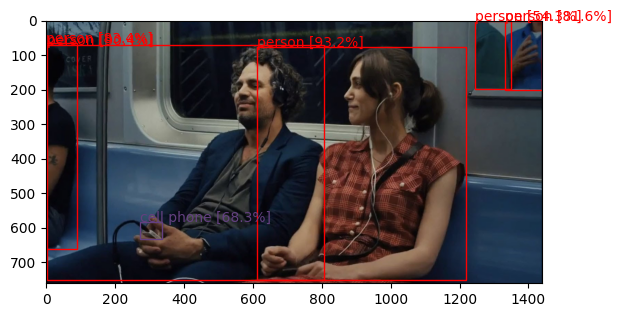


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/21 - sCmvdwF.jpg: 448x640 14 persons, 1 sports ball, 651.3ms
Speed: 1.7ms preprocess, 651.3ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


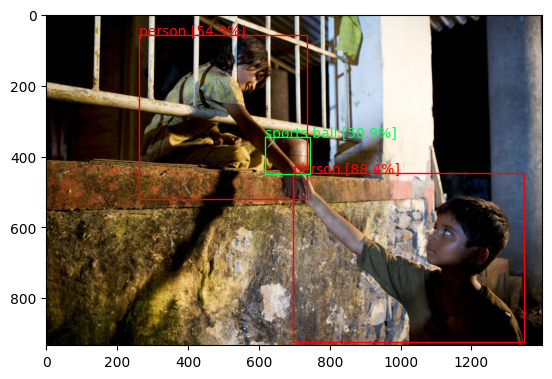


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/27 - pOoFviL.jpg: 384x640 10 persons, 632.1ms
Speed: 1.4ms preprocess, 632.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


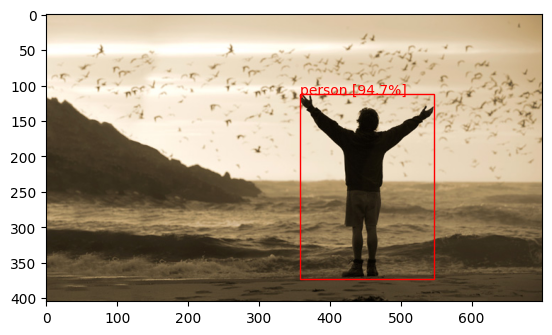


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/15 - ZXfmZiL.jpg: 384x640 15 persons, 622.3ms
Speed: 1.3ms preprocess, 622.3ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


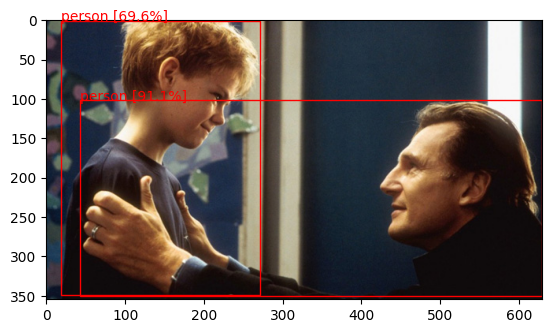


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/3 - KYS8sBQ.jpg: 448x640 20 persons, 9 handbags, 714.7ms
Speed: 1.9ms preprocess, 714.7ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)


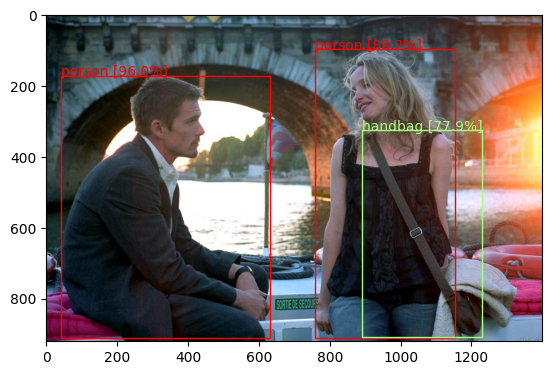


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/30 - ArQxtMj.jpg: 384x640 20 persons, 10 horses, 568.6ms
Speed: 1.8ms preprocess, 568.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


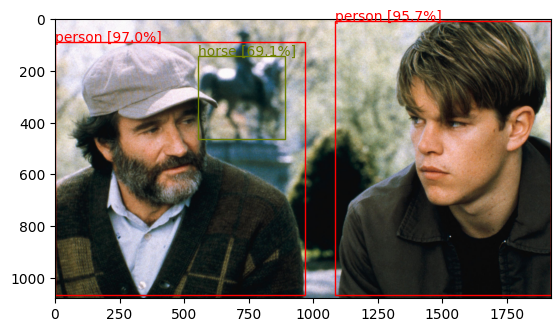


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/22 - mVYtMMH.jpg: 448x640 20 persons, 716.1ms
Speed: 1.8ms preprocess, 716.1ms inference, 0.8ms postprocess per image at shape (1, 3, 448, 640)


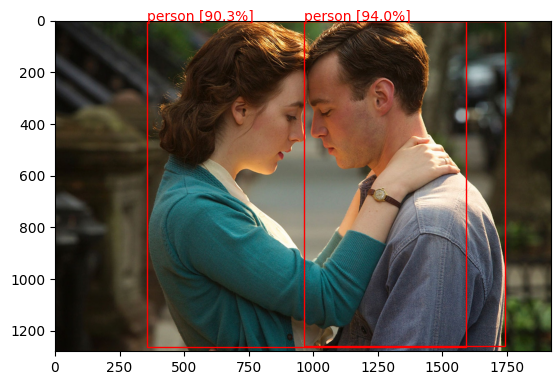


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/9 - tD8mfET.jpg: 352x640 10 persons, 575.4ms
Speed: 1.3ms preprocess, 575.4ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)


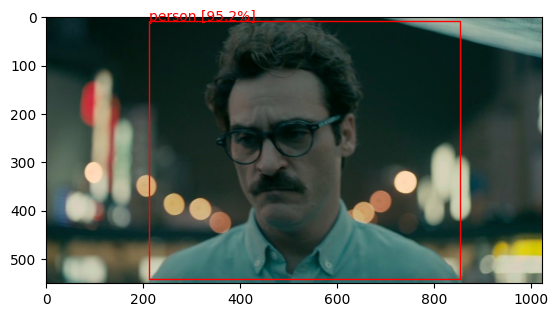


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/34 - TJHR1nA.jpg: 352x640 20 persons, 564.4ms
Speed: 1.0ms preprocess, 564.4ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)


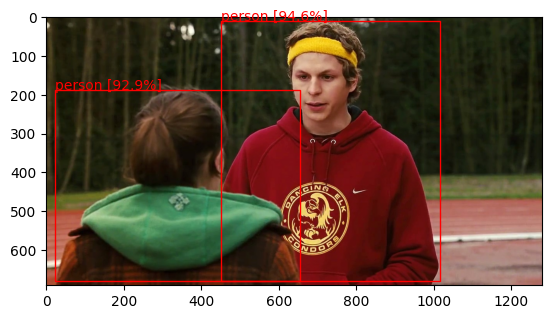


image 1/1 /home/lipeama/repos/Proj-Comp-1/images/movies/7 - MeXekuO.jpg: 384x640 50 persons, 10 cats, 10 handbags, 689.5ms
Speed: 2.2ms preprocess, 689.5ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


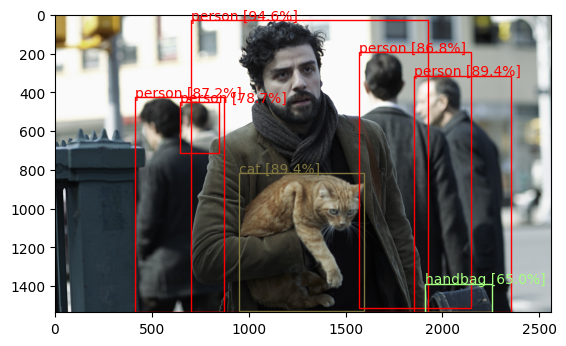

In [10]:
detectDirectory('images/movies/', iou_thresh=0.5)